<a href="https://colab.research.google.com/github/jupirifi/KRASiAnalysis/blob/main/run_KRASi_scvi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install anndata
!pip install matplotlib
!pip install numpy
!pip install pandas
!pip install scanpy
!pip install scvi-tools
!pip install igraph
!pip install leidenalg
!pip install gseapy
!pip install cnmf

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.2/176.2 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.6/58.6 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 284.1/284.1 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.2/9.2 MB 85.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 24.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 641.1/641.1 kB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 853.6/853.6 kB 34.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 259.4/259.4 kB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 58.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.7/76.7 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.4/43.4 kB 3.6 MB/s eta 0:00:00
   ━━━

In [ ]:
import anndata
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import scvi
from cnmf import cNMF

## Run scVI on Cancer dataset

In [ ]:
cancer_adata = sc.read_h5ad('cancer_20251030.h5ad').raw.to_adata()
cancer_adata.raw = cancer_adata


In [ ]:
cancer_adata

AnnData object with n_obs × n_vars = 12096 × 32285
    obs: 'CMO', 'TS-UMI', 'N_intBC', 'TS-ReadCount', 'N_unique_alleles', 'PercentUncut', 'condition', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', 'leiden', 'umap_density_condition'
    var: 'mito', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'CMO_colors', 'condition_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'umap_density_condition_params'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

In [ ]:
cancer_adata.layers["counts"] = cancer_adata.X.copy()  # preserve counts

sc.pp.highly_variable_genes(
    cancer_adata,
    n_top_genes=4000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
    batch_key="CMO",
)

sc.pp.normalize_total(cancer_adata, target_sum=1e6)
sc.pp.log1p(cancer_adata)

/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:88: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


In [ ]:
scvi.model.SCVI.setup_anndata(
    cancer_adata,
    layer="counts",
    categorical_covariate_keys=["CMO", "condition"],
    continuous_covariate_keys=["pct_counts_mito", "pct_counts_ribo"],
)

/usr/local/lib/python3.12/dist-packages/scvi/data/fields/_base_field.py:63: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [ ]:
model = scvi.model.SCVI(cancer_adata, n_layers=1, n_latent=15, gene_likelihood="nb")

In [ ]:
model.train(accelerator='gpu')

INFO: GPU available: True (cuda), used: True
INFO:lightning.pytorch.utilities.rank_zero:GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:lightning.pytorch.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Training:   0%|          | 0/400 [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=400` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=400` reached.


In [ ]:
model.history.keys()

dict_keys(['kl_weight', 'train_loss', 'elbo_train', 'reconstruction_loss_train', 'kl_local_train', 'kl_global_train'])

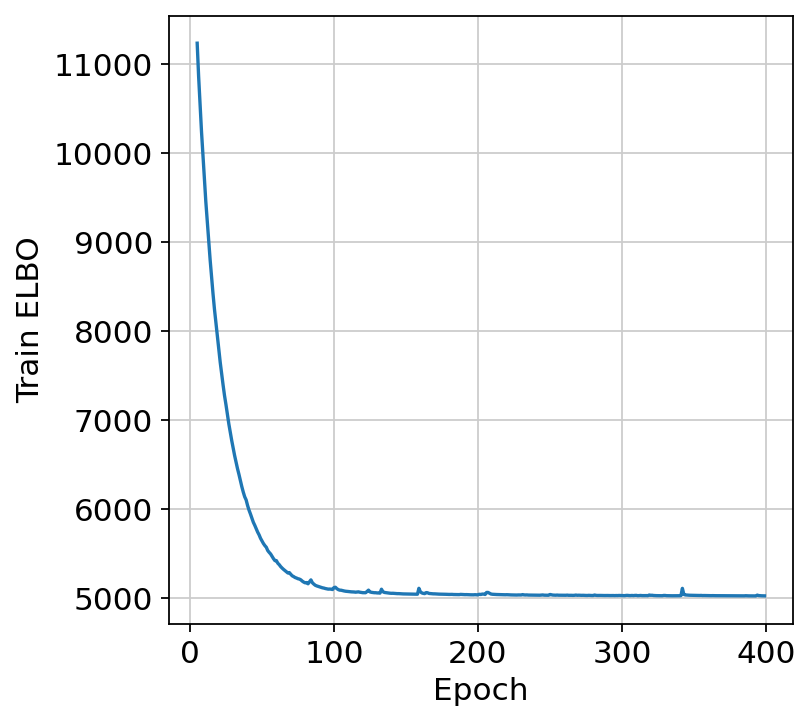

In [ ]:
plt.plot(model.history["elbo_train"].iloc[5:])
plt.xlabel("Epoch")
plt.ylabel("Train ELBO")
plt.show()

In [ ]:
#Saving the latent representation into the anndata object
SCVI_LATENT_KEY = "X_scVI"
cancer_adata.obsm[SCVI_LATENT_KEY] = model.get_latent_representation()

In [ ]:
#Clustering based on the latent representation
sc.pp.neighbors(cancer_adata, use_rep=SCVI_LATENT_KEY, n_neighbors=int(np.log2(len(cancer_adata.obs_names))))
sc.tl.umap(cancer_adata, min_dist=0.15,random_state=42)
sc.tl.leiden(cancer_adata, resolution=0.45,random_state=42)

In [ ]:
#Saving the data
#model_dir = "cancer_scvi_model_20251030"
#model.save(model_dir, overwrite=True)
#sc.write('cancer_20251030.scvi.h5ad', cancer_adata, compression='gzip')

In [ ]:
cancer_adata = sc.read_h5ad("cancer_20251030.scvi.h5ad")

cancer_adata_raw = cancer_adata.raw.to_adata()

cancer_adata_raw.layers['counts'] = cancer_adata_raw.X.copy()
cancer_adata_raw.layers['logged'] = cancer_adata_raw.X.copy()

sc.pp.normalize_total(cancer_adata_raw, target_sum=1e6)
sc.pp.log1p(cancer_adata_raw, layer='logged')

In [ ]:
#Dictiornary connecting the tumors to the barcoding oligos

cmo_to_tumor = {'CMO301': '3341_T1',
               'CMO306': '3341_T2_TM2',
               'CMO302': '3336_T1',
               'CMO305': '3341_TM1',
               'CMO304': '3333_TM1',
               'CMO311': '3337_T1',
               'CMO308': '3343_T1',
               'CMO307': '3347_T1',
               'CMO309': '3346_T1',
               'CMO303': '3337_3353_TM1',
               'CMO310': '3347_TM1',
               'CMO312': '3346_TM1',
               }
cellbc_to_cmo = dict(cancer_adata.obs['CMO'])

cancer_adata.obs['tumor'] = cancer_adata.obs['CMO'].map(cmo_to_tumor)
cancer_adata.obs['mouse'] = cancer_adata.obs.apply(lambda x: x.tumor.split("_")[0], axis=1)

Index(['CMO', 'TS-UMI', 'N_intBC', 'TS-ReadCount', 'N_unique_alleles',
       'PercentUncut', 'condition', 'n_genes_by_counts', 'total_counts',
       'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo',
       'pct_counts_ribo', 'leiden', 'umap_density_condition', '_scvi_batch',
       '_scvi_labels', 'tumor', 'mouse', 'cell_type'],
      dtype='object')


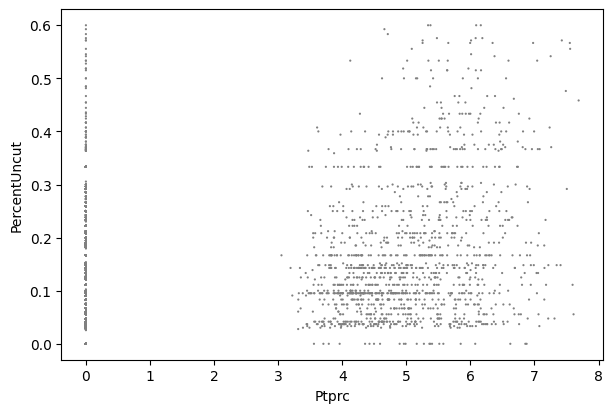

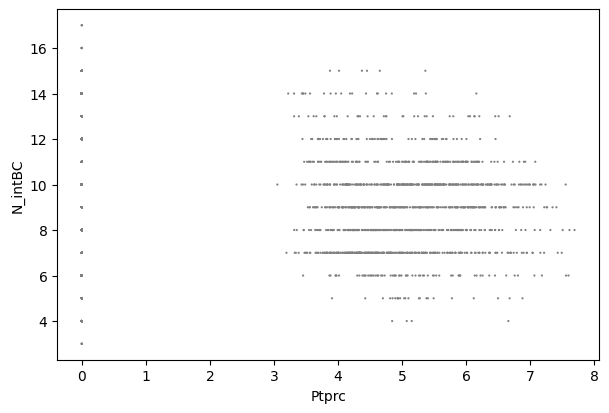

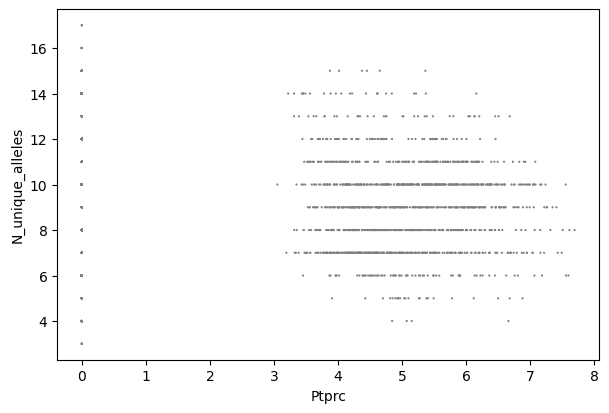

In [ ]:
print(cancer_adata.obs.columns)
cancer_adata_intBC_filtred = cancer_adata[cancer_adata.obs['N_intBC'] > 3, :].copy()
sc.pl.scatter(cancer_adata, x='Ptprc', y='PercentUncut')
sc.pl.scatter(cancer_adata, x='Ptprc', y='N_intBC')
sc.pl.scatter(cancer_adata, x='Ptprc', y='N_unique_alleles')

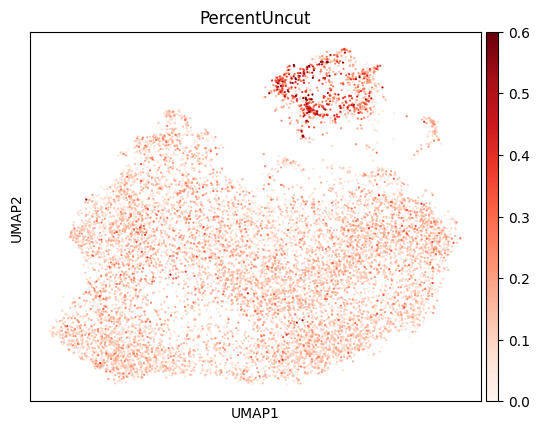

In [ ]:
sc.pl.umap(cancer_adata_intBC_filtred, color='PercentUncut', ncols=3,cmap='Reds')

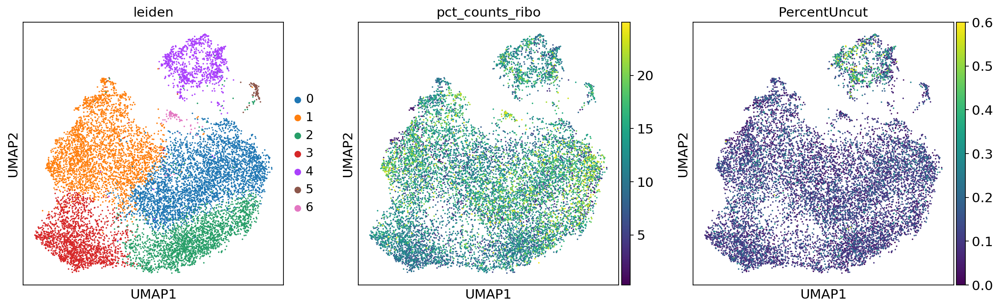

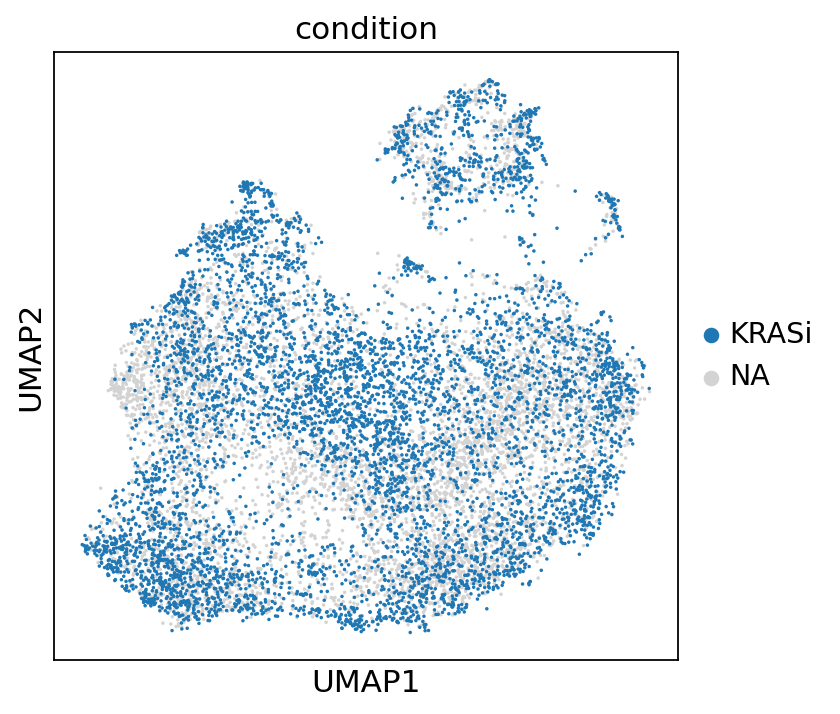

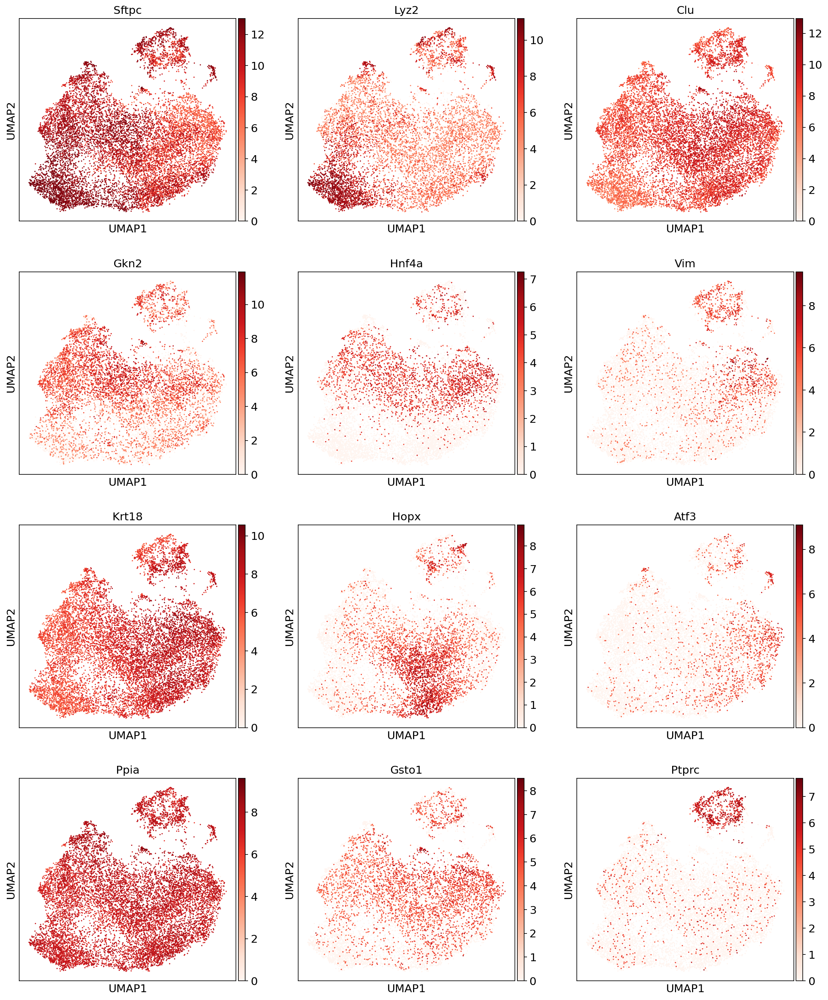

In [ ]:
#Example Plotting of the analysis


sc.set_figure_params(figsize=(5,5))
sc.pl.umap(cancer_adata, color=['leiden', 'pct_counts_ribo', 'PercentUncut'], size=10)
# sc.pl.umap(cancer_adata, color=['leiden', 'condition', 'CMO', 'PercentUncut', 'pct_counts_mito', 'n_genes_by_counts'], size=10)

sc.pl.umap(cancer_adata, color=['condition'], groups=['KRASi'], size=10)

gene_markers = ['Sftpc', 'Lyz2', 'Clu', 'Gkn2', "Hnf4a", 'Vim', 'Krt18', 'Hopx', 'Atf3', 'Ppia', 'Gsto1','Ptprc']
sc.pl.umap(cancer_adata, color=gene_markers, ncols=3,cmap='Reds')

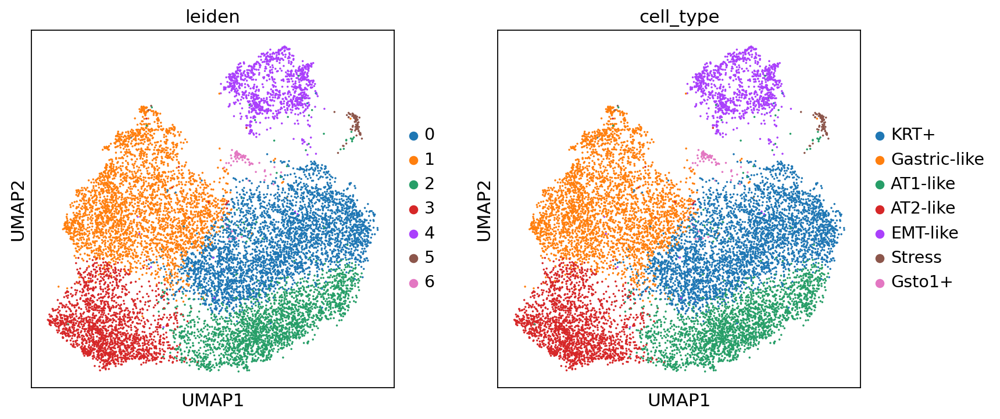

In [ ]:
cluster_to_celltype = {'0': 'KRT+', '1': 'Gastric-like', '2': 'AT1-like', '3': 'AT2-like', '4': 'EMT-like', '5': 'Stress', '6': 'Gsto1+'}
cancer_adata.obs['cell_type'] = cancer_adata.obs['leiden'].map(cluster_to_celltype)

sc.pl.umap(cancer_adata, color=['leiden', 'cell_type'], size=10)


/tmp/ipython-input-2459170242.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  counts = cancer_adata.obs.groupby(['cell_type', 'condition']).size().unstack(fill_value=0)


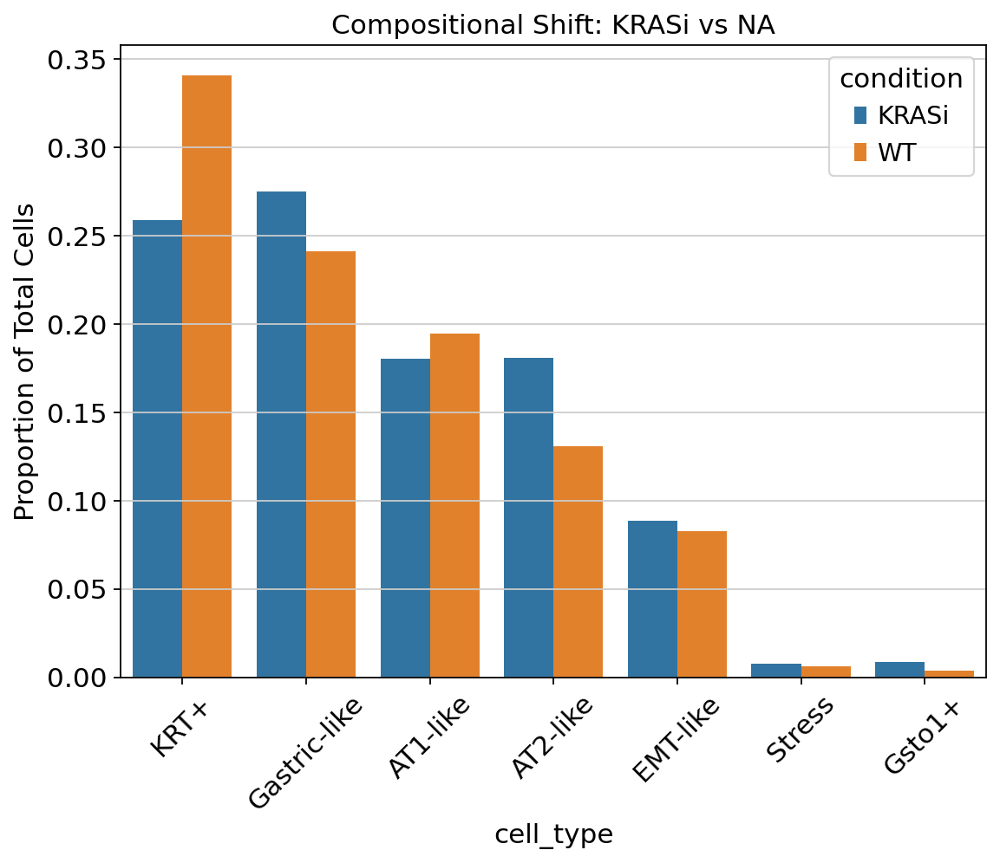

In [ ]:
#Proportion of each cluster and cluster change in the conditions

import seaborn as sns
counts = cancer_adata.obs.groupby(['cell_type', 'condition']).size().unstack(fill_value=0)
proportions = counts.div(counts.sum(axis=0), axis=1)
df_plot = proportions.reset_index().melt(id_vars='cell_type')
plt.figure(figsize=(8, 6))
sns.barplot(data=df_plot, x='cell_type', y='value', hue='condition')
plt.xticks(rotation=45)
plt.ylabel('Proportion of Total Cells')
plt.title('Compositional Shift: KRASi vs NA')
plt.show()

**DE using scanpy t-tests**


categories: KRT+, Gastric-like, AT1-like, etc.
var_group_labels: KRASi, WT


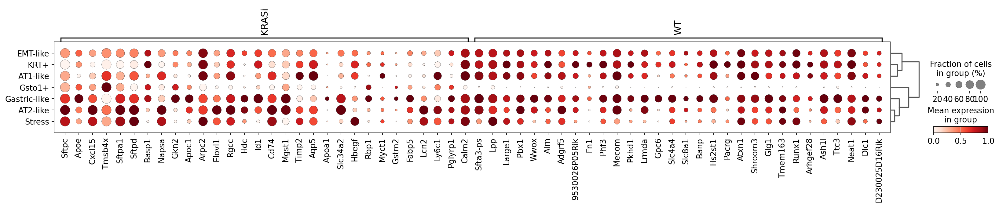

2026-01-21 18:42:30,542 [WARNING] Duplicated values found in preranked stats: 0.53% of genes
The order of those genes will be arbitrary, which may produce unexpected results.


    names     scores
0   Sftpc  31.867205
1    Apoe  30.571007
2  Cxcl15  28.094168
3  Tmsb4x  27.669519
4  Sftpa1  26.648836
5   Sftpd  25.430784
6   Basp1  23.378916
7   Napsa  21.733301
8    Gkn2  20.926775
9   Apoc1  20.753832


In [ ]:
import gseapy as gp

#Most changed genes Treatment vs KrasI
sc.tl.rank_genes_groups(cancer_adata, groupby="condition", method="wilcoxon", use_raw=False)
sc.tl.dendrogram(cancer_adata, groupby='cell_type')
sc.pl.rank_genes_groups_dotplot(cancer_adata, groupby="cell_type", standard_scale='var', n_genes=30)

res_df= sc.get.rank_genes_groups_df(cancer_adata, group='KRASi')
res_df.to_csv('tableWTxKRASi.csv')

ranking = res_df[['names', 'scores']].sort_values('scores', ascending=False)


pre_res = gp.prerank(
    rnk=ranking,
    gene_sets='MSigDB_Hallmark_2020',
    threads=4,
    min_size=5,
    max_size=1000,
    permutation_num=1000,
    outdir=None,
    seed=6
)

df= pre_res.res2d.copy()
df = df.drop(columns= ['Lead_genes', 'Gene %', 'Tag %'] )
df.to_csv('GSEA_KRASixWT_Hallmark.csv', index=False)



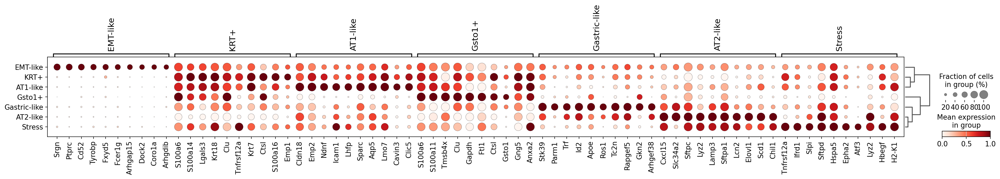

2026-01-21 19:00:12,390 [WARNING] Duplicated values found in preranked stats: 93.15% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 19:00:14,048 [WARNING] Duplicated values found in preranked stats: 93.15% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 19:00:15,671 [WARNING] Duplicated values found in preranked stats: 93.15% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 19:00:17,318 [WARNING] Duplicated values found in preranked stats: 93.15% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 19:00:18,958 [WARNING] Duplicated values found in preranked stats: 93.15% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 19:00:20,936 [WARNING] Duplicated values found in preranked stats: 93.15% of genes
The order of those genes w

In [ ]:
#Most changed genes within the leiden groups using mean expression

sc.tl.rank_genes_groups(cancer_adata, groupby="cell_type", method="wilcoxon", use_raw=False)
sc.tl.dendrogram(cancer_adata, groupby='cell_type')
sc.pl.rank_genes_groups_dotplot(cancer_adata, groupby="cell_type", standard_scale='var', n_genes=10)



all_groups = cancer_adata.obs['cell_type'].unique()
all_markers = []
for g in all_groups:
    df = sc.get.rank_genes_groups_df(cancer_adata, group=g, pval_cutoff=0.05)
    df['group'] = g  # Add a column so you know which cell type the gene belongs to
    all_markers.append(df)

table = pd.concat(all_markers)
table.to_csv('tableLeidenComparison.csv')

all_gsea_dfs = []
for g in all_groups:
    df = sc.get.rank_genes_groups_df(cancer_adata, group=g)
    ranking = res_df[['names', 'scores']].sort_values('scores', ascending=False)
    pre_res = gp.prerank(
        rnk=ranking,
        gene_sets='MSigDB_Hallmark_2020',
        threads=4,
        min_size=5,
        max_size=1000,
        permutation_num=1000,
        outdir=None,
        seed=6
    )

    out_df = pre_res.res2d.copy()
    out_df['cluster'] = g
    all_gsea_dfs.append(out_df)

final_gsea_csv = pd.concat(all_gsea_dfs)
final_gsea_csv.to_csv('GSEA_Clusters_Hallmark.csv', index=False)




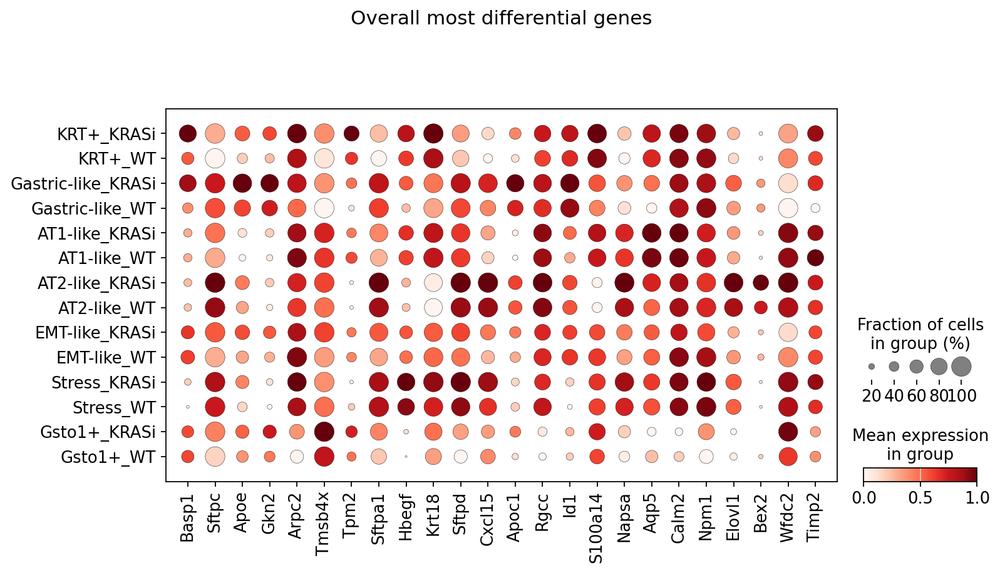

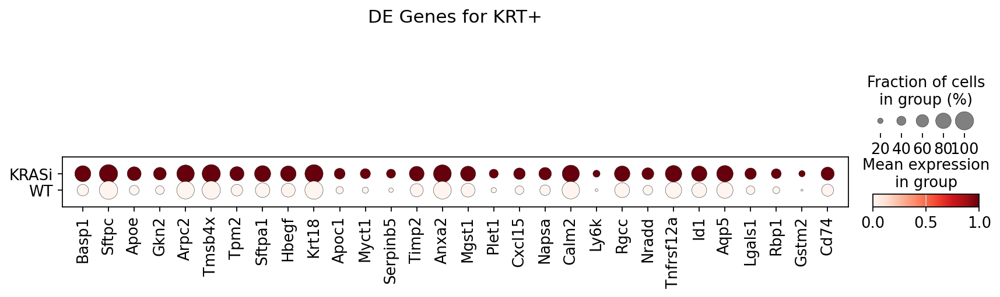

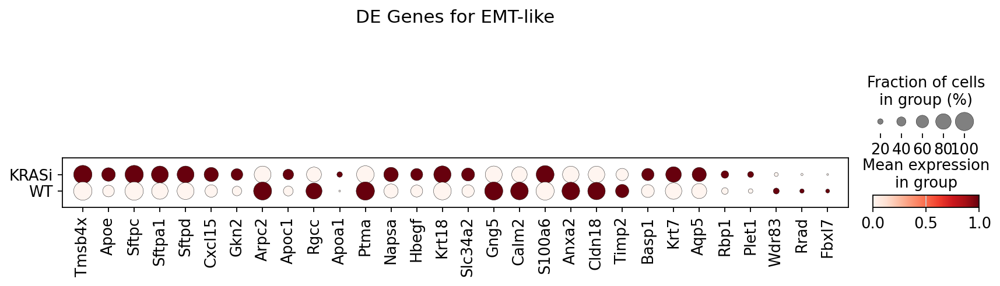

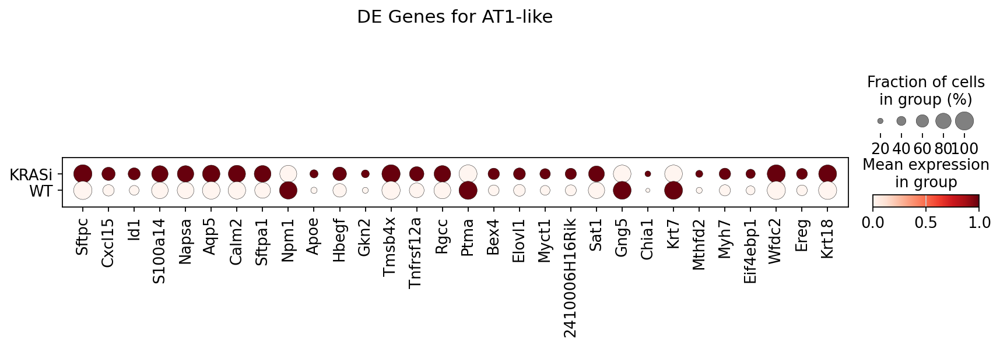

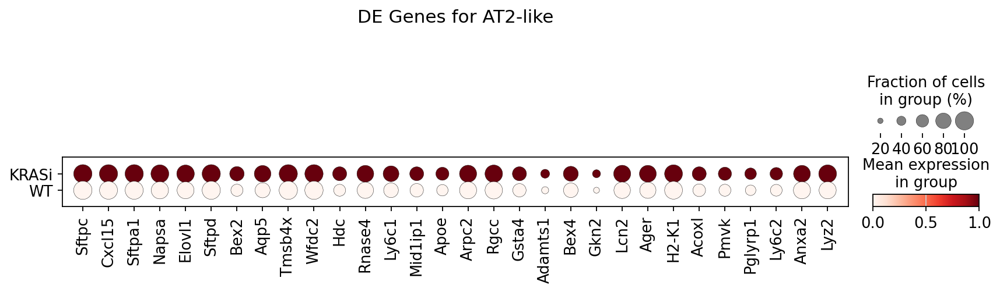

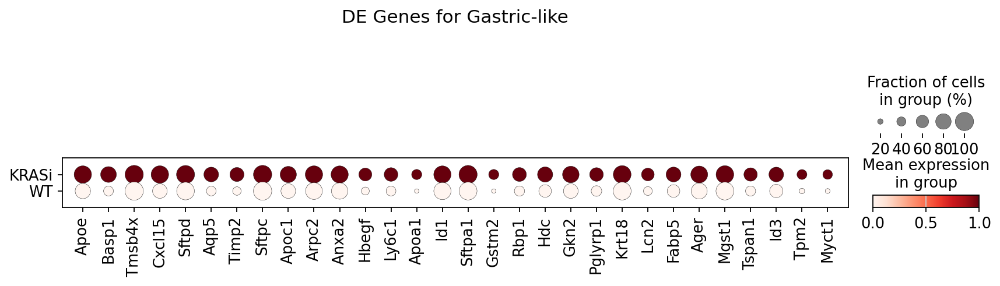

Not enough genes for Stress
Not enough genes for Gsto1+


In [ ]:
all_de_tables = []
cluster_de_results = {}

for cluster in cancer_adata.obs['cell_type'].unique():
    subsetad = cancer_adata[cancer_adata.obs['cell_type'] == cluster].copy()
    sc.tl.rank_genes_groups(subsetad, groupby="condition", method="wilcoxon", use_raw=False)

    df = sc.get.rank_genes_groups_df(subsetad, group='KRASi',pval_cutoff=0.05)
    df['cluster'] = cluster
    df['cell_type'] = cluster_to_celltype.get(str(cluster), "Unknown")

    cluster_de_results[cluster] = df
    all_de_tables.append(df)

pd.concat(all_de_tables).to_csv('cluster_specific_KRASi_vs_WT_DE.csv', index=False)

top_genes_all = list(dict.fromkeys([gene for df in cluster_de_results.values() for gene in df.sort_values('scores', ascending=False).head(10)['names']]))

sc.pl.dotplot(cancer_adata, var_names=top_genes_all, groupby=['cell_type', 'condition'], standard_scale='var', title="Overall most differential genes")

for cluster, df in cluster_de_results.items():
    top_genes_cluster = df.sort_values('scores', ascending=False).head(30)['names'].tolist()
    if len(top_genes_cluster)>2:
      sc.pl.dotplot(cancer_adata[cancer_adata.obs['cell_type'] == cluster], var_names=top_genes_cluster, groupby='condition', standard_scale='var', title=f"DE Genes for {cluster}")
    else:
      print(f"Not enough genes for {cluster}")

In [ ]:
sc.get.rank_genes_groups_df(cancer_adata,group='cell_type', pval_cutoff=0.05, log2fc_min=1)

Index(['CMO', 'TS-UMI', 'N_intBC', 'TS-ReadCount', 'N_unique_alleles',
       'PercentUncut', 'condition', 'n_genes_by_counts', 'total_counts',
       'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo',
       'pct_counts_ribo', 'leiden', 'umap_density_condition', '_scvi_batch',
       '_scvi_labels', 'tumor', 'mouse', 'cell_type', 'at2', 'at1',
       'early_gastric', 'gastric', 'late_gastric', 'endoderm',
       'high_plasticity', 'pre_emt', 'early_emt', 'mesenchymal',
       'neuronal_like', '_scvi_raw_norm_scaling'],
      dtype='object')


KeyError: "None of [Index(['cell_type'], dtype='object')] are in the [columns]"

**Cellular Programs**

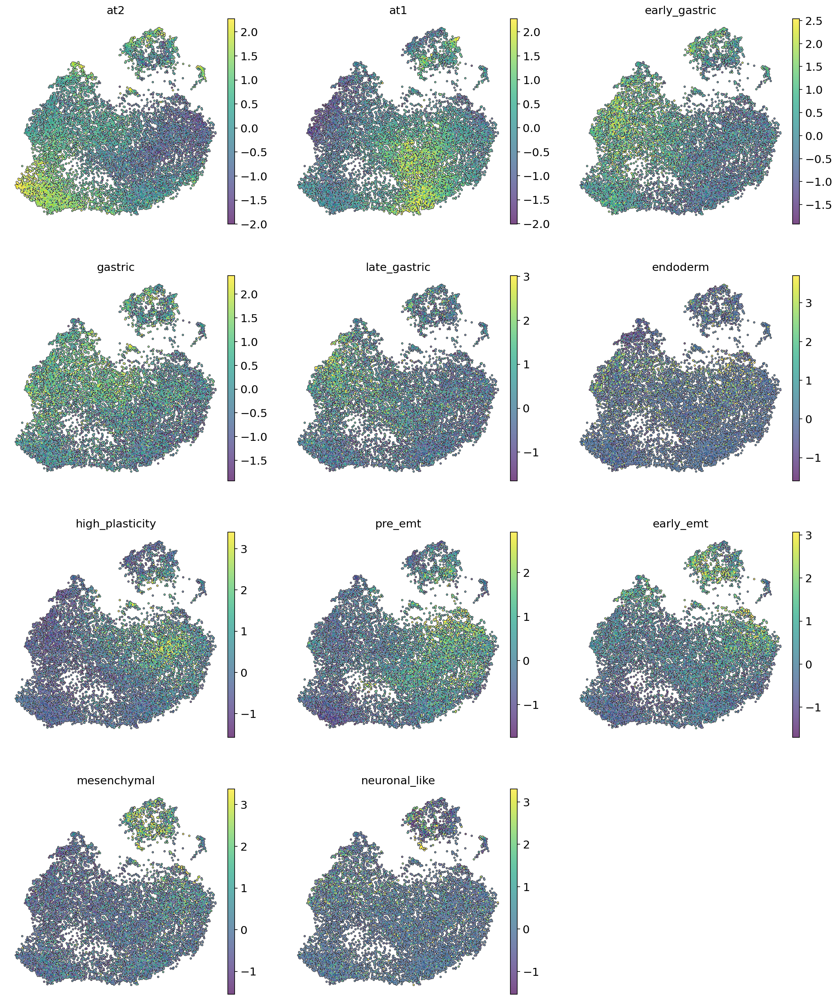

In [ ]:
at2_programs = ['Sftpa1', 'Sftpb', 'Sftpc', 'Sftpd', 'Cxcl15', 'Lyz2', 'Cd74']
at1_programs = ['Hopx', 'Ager', 'Pdpn', 'Aqp5', 'Clic5']
early_gastric = ['Cacna1a', 'Fmo1', 'Kng2', 'Pim1', 'Gm29340', 'Meg3']
gastric_like = ['Hs3st5', 'Kctd8', 'Clstn2', 'Gkn2']
late_gastric = ['Sfmbt2', 'Chrna9', 'Kcnq5', 'Rlbp1', 'Shisa9', 'Fras1', 'Folr1', 'Agxt2', 'Ppp1r3a']
endoderm_like = ['Pyy', 'Spatc1', 'Hccs', 'Hif3a', 'Col15a1']
high_plasticity = ['Akr1d1', 'Mcpt1', 'Mcpt2', 'Mroh4', 'Tmem266', 'Vstm5', 'Dysf', 'Cldn2', 'Procr']
pre_emt = ['Ntm', 'Clu', 'Onecut3', 'Rmst', 'Fn1', 'Lmcd1', 'Ccbe1']
early_emt = ['Tg', 'Dock10', 'Cenpe', 'Top2a', 'Vim', 'Fbln2', 'Zeb2', 'Hmga2', 'Lgals1', 'Inhba']
mesenchymal = ['Vim', 'Zeb1', 'Zeb2', 'Twist1', 'Tgfb1']
neuronal_like = ['Ldb2', 'Calcrl', 'Cyyr1', 'Piezo2', 'Fgd2', 'Sparcl1', 'Shank3', 'Vwf', 'Acer2', 'Ebf1', 'Robo1', 'Robo2']

program_names = ['at2', 'at1', 'early_gastric', 'gastric', 'late_gastric', 'endoderm',
                 'high_plasticity', 'pre_emt', 'early_emt', 'mesenchymal', 'neuronal_like']

programs = [at2_programs, at1_programs, early_gastric, gastric_like, late_gastric, endoderm_like,
            high_plasticity, pre_emt, early_emt, mesenchymal, neuronal_like]


for program_name, program in zip(program_names, programs):
    sc.tl.score_genes(cancer_adata,
                      program,
                      ctrl_size=len(program), n_bins=30,
                      score_name=program_name, use_raw=False)

    cancer_adata.obs[program_name] = (cancer_adata.obs[program_name] - cancer_adata.obs[program_name].mean()) / cancer_adata.obs[program_name].std()


sc.pl.umap(
    cancer_adata,
    color=program_names,
    frameon=False,
    ncols=3,
    vmin='p1',
    vmax='p99',
    add_outline=True
)

In [ ]:
#GSEA per cluster for Krasi and WT

all_gsea_dfs = []

for cluster_name, res_df in cluster_de_results.items():
    ranking = res_df[['names', 'scores']].sort_values('scores', ascending=False)
    if ranking.empty:
        print(f"NaN values found in ranking for cluster {cluster_name}")
    else:
      pre_res = gp.prerank(
          rnk=ranking,
          gene_sets='MSigDB_Hallmark_2020',
          threads=4,
          min_size=5,
          max_size=1000,
          permutation_num=1000,
          outdir=None,
          seed=6
      )

      out_df = pre_res.res2d.copy()
      out_df['cluster'] = cluster_name
      all_gsea_dfs.append(out_df)

final_gsea_csv = pd.concat(all_gsea_dfs)
final_gsea_csv.to_csv('GSEA_All_Clusters_Hallmark.csv', index=False)

final_gsea_csv['FDR q-val'] = pd.to_numeric(final_gsea_csv['FDR q-val'], errors='coerce')
plot_df = final_gsea_csv[final_gsea_csv['FDR q-val'] < 0.05].copy()
plot_df['log_fdr'] = -np.log10(plot_df['FDR q-val'] + 1e-10)




2026-01-21 18:47:43,025 [WARNING] Duplicated values found in preranked stats: 6.85% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 18:47:44,662 [WARNING] Duplicated values found in preranked stats: 13.98% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 18:47:46,415 [WARNING] Duplicated values found in preranked stats: 17.12% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 18:47:48,535 [WARNING] Duplicated values found in preranked stats: 20.95% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 18:47:50,217 [WARNING] Duplicated values found in preranked stats: 7.80% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2026-01-21 18:47:51,867 [WARNING] Duplicated values found in preranked stats: 85.70% of genes
The order of those genes wil

**cNMF**

In [ ]:
sc.pp.highly_variable_genes(
    cancer_adata_raw,
    n_top_genes=4000,
    subset=True,
    layer="counts",
    flavor="seurat_v3",
    batch_key="CMO",
)

sc.pp.filter_cells(cancer_adata_raw, min_genes=200)
sc.pp.filter_cells(cancer_adata_raw, min_counts=500)


/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:88: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 82.
[Worker 0]. Starting task 83.
[Worker 0]. Starting task 84.
[Worker 0]. Starting task 85.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 86.
[Worker 0]. Starting task 87.
[Worker 0]. Starting task 88.
[Worker 0]. Starting task 89.
[Worker 0]. Starting task 90.
[Worker 0]. Starting task 91.
[Worker 0]. Starting task 92.
[Worker 0]. Starting task 93.
[Worker 0]. Starting task 94.
[Worker 0]. Starting task 95.
[Worker 0]. Starting task 96.
[Worker 0]. Starting task 97.
[Worker 0]. Starting task 98.
[Worker 0]. Starting task 99.
[Worker 0]. Starting task 100.
[Worker 0]. Starting task 101.
[Worker 0]. Starting task 102.
[Worker 0]. Starting task 103.
[Worker 0]. Starting task 104.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 105.
[Worker 0]. Starting task 106.
[Worker 0]. Starting task 107.
[Worker 0]. Starting task 108.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 109.
[Worker 0]. Starting task 110.
[Worker 0]. Starting task 111.
[Worker 0]. Starting task 112.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 113.
[Worker 0]. Starting task 114.
[Worker 0]. Starting task 115.
[Worker 0]. Starting task 116.
[Worker 0]. Starting task 117.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 118.
[Worker 0]. Starting task 119.
[Worker 0]. Starting task 120.
[Worker 0]. Starting task 121.
[Worker 0]. Starting task 122.
[Worker 0]. Starting task 123.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 124.
[Worker 0]. Starting task 125.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 126.
[Worker 0]. Starting task 127.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 128.
[Worker 0]. Starting task 129.
[Worker 0]. Starting task 130.
[Worker 0]. Starting task 131.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 132.
[Worker 0]. Starting task 133.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 134.
[Worker 0]. Starting task 135.
[Worker 0]. Starting task 136.
[Worker 0]. Starting task 137.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 138.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 139.
[Worker 0]. Starting task 140.
[Worker 0]. Starting task 141.
[Worker 0]. Starting task 142.
[Worker 0]. Starting task 143.
[Worker 0]. Starting task 144.
[Worker 0]. Starting task 145.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 146.
[Worker 0]. Starting task 147.
[Worker 0]. Starting task 148.
[Worker 0]. Starting task 149.
[Worker 0]. Starting task 150.
[Worker 0]. Starting task 151.
[Worker 0]. Starting task 152.
[Worker 0]. Starting task 153.
[Worker 0]. Starting task 154.
[Worker 0]. Starting task 155.
[Worker 0]. Starting task 156.
[Worker 0]. Starting task 157.
[Worker 0]. Starting task 158.
[Worker 0]. Starting task 159.


/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 1000 reached. Increase it to improve convergence.
  warnings.warn(


[Worker 0]. Starting task 160.
[Worker 0]. Starting task 161.
[Worker 0]. Starting task 162.
[Worker 0]. Starting task 163.
[Worker 0]. Starting task 164.
[Worker 0]. Starting task 165.
[Worker 0]. Starting task 166.
[Worker 0]. Starting task 167.
[Worker 0]. Starting task 168.
[Worker 0]. Starting task 169.
[Worker 0]. Starting task 170.
[Worker 0]. Starting task 171.
[Worker 0]. Starting task 172.
[Worker 0]. Starting task 173.
[Worker 0]. Starting task 174.
[Worker 0]. Starting task 175.
[Worker 0]. Starting task 176.
[Worker 0]. Starting task 177.
[Worker 0]. Starting task 178.
[Worker 0]. Starting task 179.
Combining factorizations for k=3.
Combining factorizations for k=4.
Combining factorizations for k=5.
Combining factorizations for k=6.
Combining factorizations for k=7.
Combining factorizations for k=8.
Combining factorizations for k=9.
Combining factorizations for k=10.
Combining factorizations for k=11.


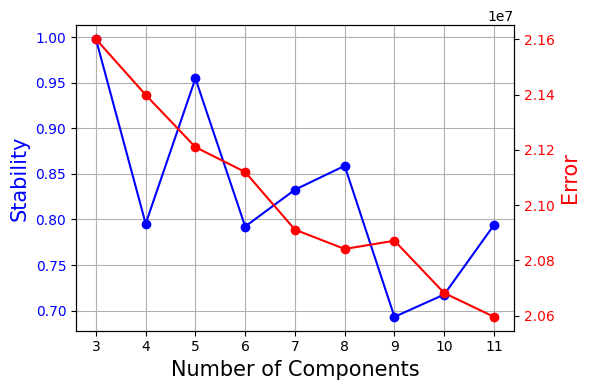

In [ ]:
cnmf_obj = cNMF(output_dir="./cnmf_results4000", name="KRASi_analysis")

counts_path = "./cnmf_results4000/counts_for_cnmf.h5ad"
cancer_adata_raw.write(counts_path)
cnmf_obj.prepare(counts_fn=counts_path, components=np.arange(3, 12), n_iter=20, seed=14,num_highvar_genes=4000)
cnmf_obj.factorize(worker_i=0, total_workers=1)
cnmf_obj.combine()
cnmf_obj.k_selection_plot() # Look for the "elbow" where stability is high and error is low

/usr/lib/python3.12/functools.py:912: UserWarning: Received a view of an AnnData. Making a copy.
  return dispatch(args[0].__class__)(*args, **kw)


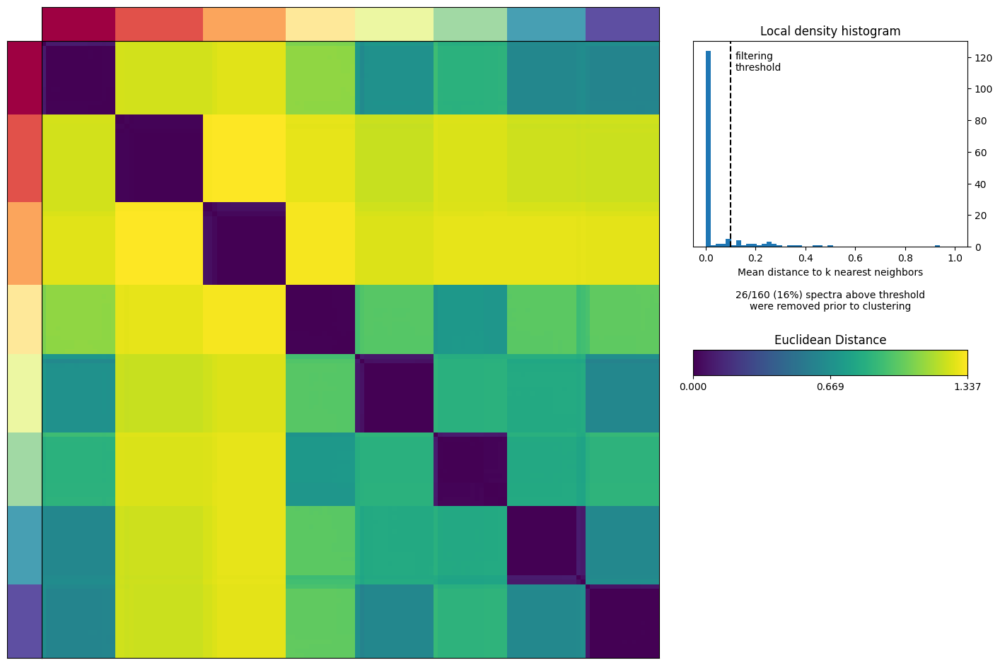

In [ ]:
k_selected = 8
cnmf_obj.consensus(k=k_selected, density_threshold=0.1,show_clustering=True, close_clustergram_fig=False)

usage, spectra_scores, spectra_tpm, top_genes = cnmf_obj.load_results(K=k_selected, density_threshold=0.1)



In [ ]:
#Re-loading the results
cnmf_obj = cNMF(output_dir="./cnmf_results", name="KRASi_analysis")
usage, spectra_scores, spectra_tpm, top_genes = cnmf_obj.load_results(
    K=6,
    density_threshold=0.1
)

FileNotFoundError: [Errno 2] No such file or directory: './cnmf_results/KRASi_analysis/KRASi_analysis.gene_spectra_score.k_6.dt_0_1.txt'

In [ ]:
# 0. Define the mapping
program_map = {
    1: 'AT1-like',
    2: 'AT2-like',
    3: 'Injury Response/PATS Program',
    4: 'High Plasticity (Dlk1-Dio3+)',
    5: 'Cytoskeleton',
    6: 'Gastric-like/Cholesterol Metabolism',
    7: 'Immune-like/IL-1B+',
    8: 'Noise'
}


cancer_adata_cnmf = cancer_adata[usage.index, :].copy()
usage_with_meta = usage.copy()
usage_with_meta['condition'] = cancer_adata_cnmf.obs['condition'].values

avg_usage = usage_with_meta.groupby('condition').mean()
comparison = avg_usage.T

comparison.index = comparison.index.map(program_map)

comparison['fold_change'] = comparison['KRASi'] / (comparison['WT'] + 1e-6)
comparison = comparison.sort_values('fold_change', ascending=False)

print("Programs ranked by KRASi specificity:")
print(comparison)

comparison[['KRASi', 'WT']].plot(kind='bar', figsize=(12, 6))
plt.title('Average Program Usage: KRASi vs WT')
plt.ylabel('Mean Usage Score')
plt.xlabel('Biological Programs')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Condition')
plt.tight_layout()
plt.show()

for prog_id, prog_name in program_map.items():
    cancer_adata_cnmf.obs[prog_name] = usage[prog_id]

program_names = list(program_map.values())

sc.pl.umap(cancer_adata_cnmf, color=program_names, cmap='magma', ncols=3)

NameError: name 'cancer_adata' is not defined

In [ ]:
cmo_to_tumor = {
    'CMO301': '3341_T1', 'CMO306': '3341_T2_TM2', 'CMO302': '3336_T1',
    'CMO305': '3341_TM1', 'CMO304': '3333_TM1', 'CMO311': '3337_T1',
    'CMO308': '3343_T1', 'CMO307': '3347_T1', 'CMO309': '3346_T1',
    'CMO303': '3337_3353_TM1', 'CMO310': '3347_TM1', 'CMO312': '3346_TM1'
}


cancer_adata_cnmf.obs['tumor'] = cancer_adata_cnmf.obs['CMO'].map(cmo_to_tumor)
cancer_adata_cnmf.obs['mouse'] = cancer_adata_cnmf.obs['tumor'].str.split('_').str[0]


baseline_tb_map = {
    '3341_T1': 'High', '3341_T2_TM2': 'High', '3341_TM1': 'High',
    '3336_T1': 'Low',
    '3333_TM1': 'Medium',
    '3343_T1': 'High',
    '3346_T1': 'High', '3346_TM1': 'High',
    '3347_T1': 'Medium', '3347_TM1': 'Medium',
    '3337_T1': 'High', '3337_3353_TM1': 'High'
}

sample_type_map = {
    '3341_T1': 'Tumor', '3341_T2_TM2': 'Tumor', '3341_TM1': 'Tumor Mix',
    '3336_T1': 'Tumor',
    '3333_TM1': 'Tumor Mix',
    '3343_T1': 'Tumor',
    '3346_T1': 'Tumor', '3346_TM1': 'Tumor Mix',
    '3347_T1': 'Tumor', '3347_TM1': 'Tumor Mix',
    '3337_T1': 'Tumor', '3337_3353_TM1': 'Tumor Mix'
}

cancer_adata_cnmf.obs['baseline_tb'] = cancer_adata_cnmf.obs['tumor'].map(baseline_tb_map)
cancer_adata_cnmf.obs['sample_type'] = cancer_adata_cnmf.obs['tumor'].map(sample_type_map)


cancer_adata_cnmf.obs['baseline_tb'] = cancer_adata_cnmf.obs['baseline_tb'].astype('category')
cancer_adata_cnmf.obs['sample_type'] = cancer_adata_cnmf.obs['sample_type'].astype('category')

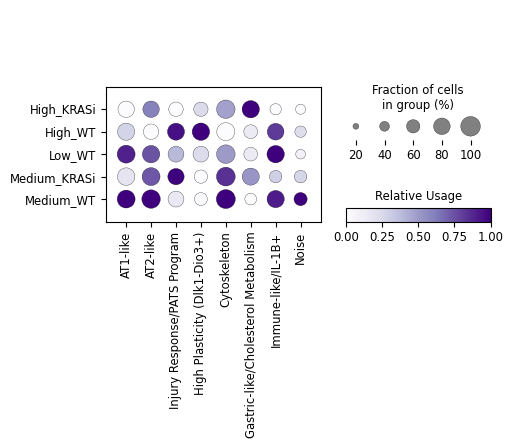

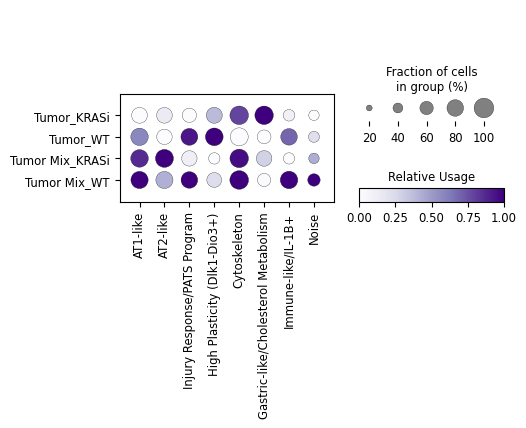

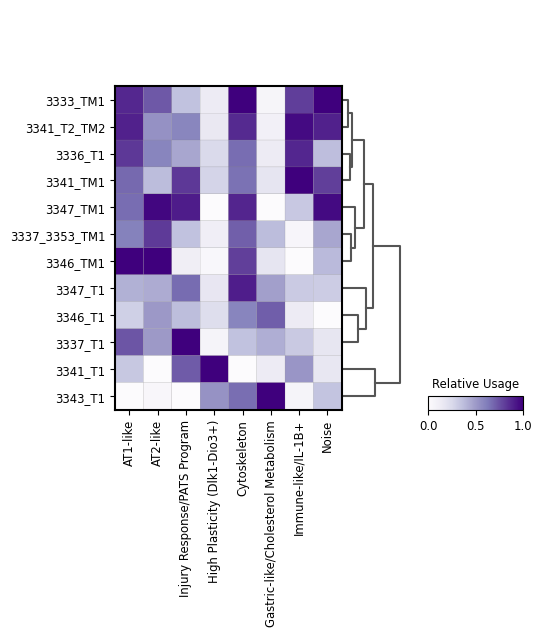

In [ ]:




sc.pl.dotplot(
    cancer_adata_cnmf,
    var_names=program_names,
    groupby=['baseline_tb','condition'],
    cmap='Purples',
    standard_scale='var',
    colorbar_title='Relative Usage',
)



sc.pl.dotplot(
    cancer_adata_cnmf,
    var_names=program_names,
    groupby=['sample_type', 'condition'],
    cmap='Purples',
    standard_scale='var',
    colorbar_title='Relative Usage',
)

sc.tl.dendrogram(
    cancer_adata_cnmf,
    groupby='tumor',
    use_rep=None,
    var_names=program_names
)

sc.pl.matrixplot(
    cancer_adata_cnmf,
    var_names=program_names,
    groupby='tumor',
    cmap='Purples',
    standard_scale='var',
    colorbar_title='Relative Usage',
    dendrogram=True
)

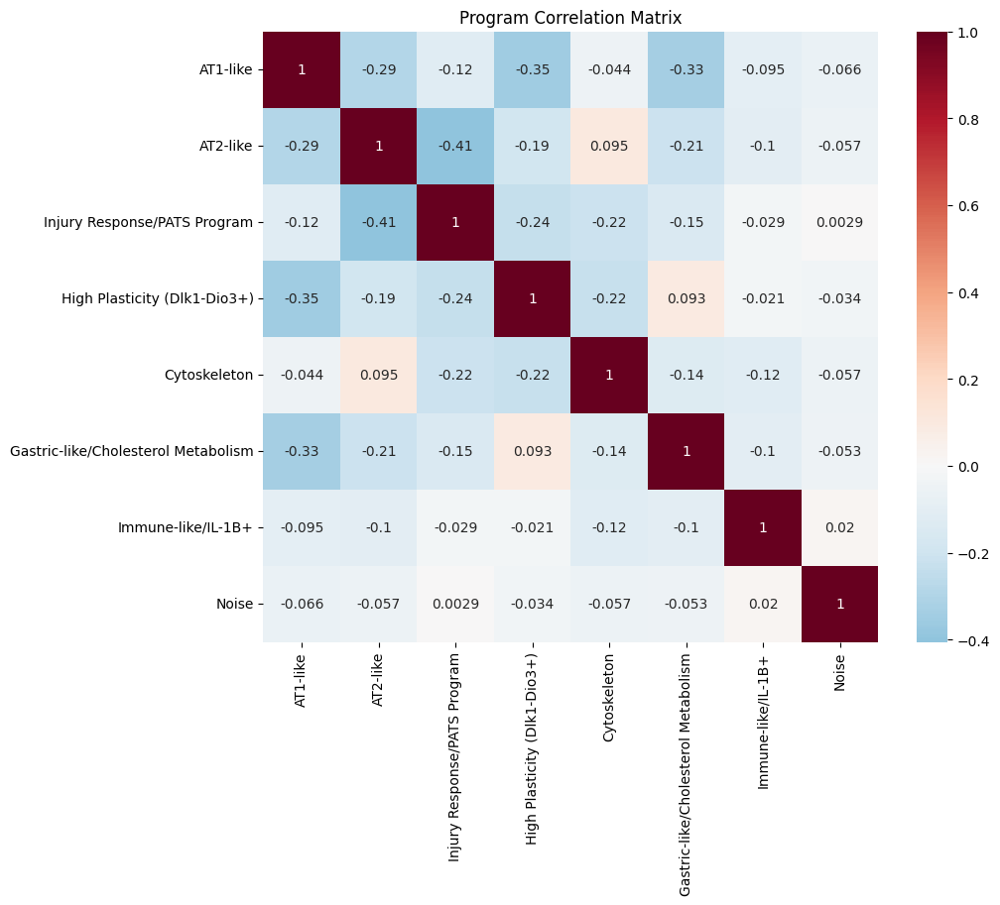

In [ ]:

program_usage = cancer_adata_cnmf.obs[program_names]
corr_matrix = program_usage.corr(method='pearson')
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='RdBu_r', center=0)
plt.title('Program Correlation Matrix')
plt.show()

<Figure size 800x800 with 0 Axes>

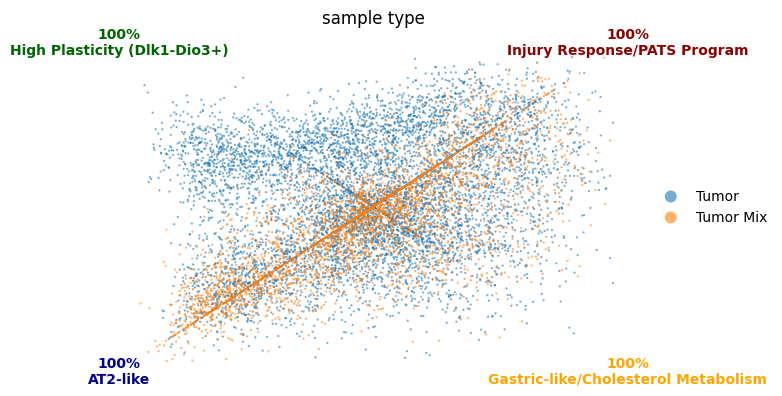

In [ ]:



x_raw = cancer_adata_cnmf.obs['Injury Response/PATS Program'] - cancer_adata_cnmf.obs['AT2-like']
y_raw = cancer_adata_cnmf.obs['High Plasticity (Dlk1-Dio3+)'] - cancer_adata_cnmf.obs['Gastric-like/Cholesterol Metabolism']

rotation_factor = np.sqrt(2) / 2
cancer_adata_cnmf.obs['quadrant_x'] = (x_raw - y_raw) * rotation_factor
cancer_adata_cnmf.obs['quadrant_y'] = (x_raw + y_raw) * rotation_factor

plt.figure(figsize=(8, 8))

sc.pl.scatter(
    cancer_adata_cnmf,
    x='quadrant_x',
    y='quadrant_y',
    color=['sample_type'],
    size=10,
    alpha=0.6,
    show=False
)



limit = 0.8
plt.xlim(-limit, limit)
plt.ylim(-limit, limit)
plt.axis('off')

plt.text(0.75, 0.75, '100%\nInjury Response/PATS Program', ha='center', va='center', fontweight='bold', color='darkred')
plt.text(-0.75, -0.75, '100%\nAT2-like', ha='center', va='center', fontweight='bold', color='darkblue')
plt.text(-0.75, 0.75, '100%\nHigh Plasticity (Dlk1-Dio3+)', ha='center', va='center', fontweight='bold', color='darkgreen')
plt.text(0.75, -0.75, '100%\nGastric-like/Cholesterol Metabolism', ha='center', va='center', fontweight='bold', color='orange')


plt.show()

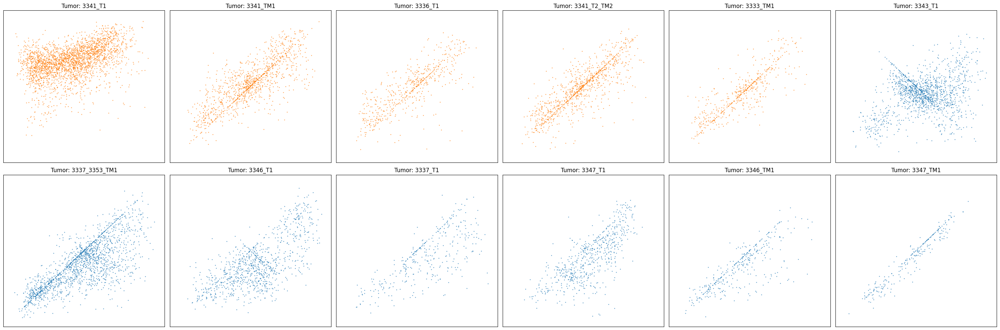

In [ ]:

x_raw = cancer_adata_cnmf.obs['Injury Response/PATS Program'] - cancer_adata_cnmf.obs['AT2-like']
y_raw = cancer_adata_cnmf.obs['High Plasticity (Dlk1-Dio3+)'] - cancer_adata_cnmf.obs['Gastric-like/Cholesterol Metabolism']

rotation_factor = np.sqrt(2) / 2
cancer_adata_cnmf.obs['quadrant_x'] = (x_raw - y_raw) * rotation_factor
cancer_adata_cnmf.obs['quadrant_y'] = (x_raw + y_raw) * rotation_factor


tumors = cancer_adata_cnmf.obs['tumor'].unique()
ncols = 6
nrows = 2

fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))
axes = axes.flatten()
limit = 0.8

for i, tumor in enumerate(cancer_adata_cnmf.obs['tumor'].unique()):
    ax = axes[i]
    subset = cancer_adata_cnmf[cancer_adata_cnmf.obs['tumor'] == tumor]

    sc.pl.scatter(
        subset,
        x='quadrant_x',
        y='quadrant_y',
        color='condition',
        size=15,
        alpha=0.7,
        ax=ax,
        show=False,
        legend_loc='none'
    )

    ax.set_xlim(-limit, limit)
    ax.set_ylim(-limit, limit)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel("")
    ax.set_ylabel("")


    #ax.text(0.9, 0.81, '100%\nInjury Response\nPATS Program', ha='center', fontweight='bold', color='darkred', fontsize=8)
    #ax.text(-0.92, -0.9, '100%\nAT2-like', ha='center', fontweight='bold', color='darkblue', fontsize=8)
    #ax.text(-0.92, 0.81, '100%\nHigh Plasticity (Dlk1-Dio3+)', ha='center', fontweight='bold', color='darkgreen', fontsize=8)
    #ax.text(0.9, -0.9, '100%\nGastric-like/Cholesterol Metabolism', ha='center', fontweight='bold', color='orange', fontsize=8)

    ax.set_title(f"Tumor: {tumor}", fontsize=12)


plt.tight_layout()
plt.show()

In [ ]:
print(cancer_adata_cnmf.obs.columns)

Index(['CMO', 'TS-UMI', 'N_intBC', 'TS-ReadCount', 'N_unique_alleles',
       'PercentUncut', 'condition', 'n_genes_by_counts', 'total_counts',
       'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo',
       'pct_counts_ribo', 'leiden', 'umap_density_condition', '_scvi_batch',
       '_scvi_labels', 'tumor', 'mouse', 'cell_type', 'AT1-like', 'AT2-like',
       'Injury Response/PATS Program', 'High Plasticity (Dlk1-Dio3+)',
       'Cytoskeleton', 'Gastric-like/Cholesterol Metabolism',
       'Immune-like/IL-1B+', 'Noise', 'baseline_tb', 'sample_type'],
      dtype='object')


NameError: name 'cnmf_obj' is not defined

##Immune Dataset
---

In [ ]:
immune_adata= sc.read_h5ad('immune_20251030.scvi.h5ad').raw.to_adata()
immune_adata.raw=immune_adata

immune_adata.layers["counts"] = immune_adata.X.copy()

In [ ]:
sc.pp.filter_cells(immune_adata, min_genes=200)
sc.pp.filter_cells(immune_adata, min_counts=500)



In [ ]:
raw_counts_adata = sc.AnnData(X=immune_adata.layers['counts'], obs=immune_adata.obs, var=immune_adata.var)
raw_counts_adata.write("./cnmf_raw_counts.h5ad")

[Worker 0]. Starting task 0.
[Worker 0]. Starting task 1.
[Worker 0]. Starting task 2.
[Worker 0]. Starting task 3.
[Worker 0]. Starting task 4.
[Worker 0]. Starting task 5.
[Worker 0]. Starting task 6.
[Worker 0]. Starting task 7.
[Worker 0]. Starting task 8.
[Worker 0]. Starting task 9.
[Worker 0]. Starting task 10.
[Worker 0]. Starting task 11.
[Worker 0]. Starting task 12.
[Worker 0]. Starting task 13.
[Worker 0]. Starting task 14.
[Worker 0]. Starting task 15.
[Worker 0]. Starting task 16.
[Worker 0]. Starting task 17.
[Worker 0]. Starting task 18.
[Worker 0]. Starting task 19.
[Worker 0]. Starting task 20.
[Worker 0]. Starting task 21.
[Worker 0]. Starting task 22.
[Worker 0]. Starting task 23.
[Worker 0]. Starting task 24.
[Worker 0]. Starting task 25.
[Worker 0]. Starting task 26.
[Worker 0]. Starting task 27.
[Worker 0]. Starting task 28.
[Worker 0]. Starting task 29.
[Worker 0]. Starting task 30.
[Worker 0]. Starting task 31.
[Worker 0]. Starting task 32.
[Worker 0]. Starting

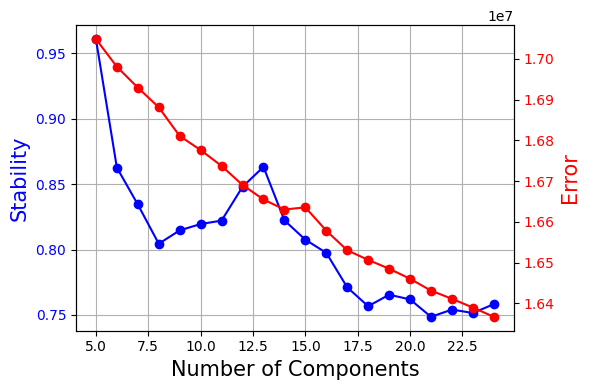

In [ ]:
cnmf_obj = cNMF(output_dir="./cnmf_immune5-25", name="KRASi_analysis")

cnmf_obj.prepare(counts_fn='cnmf_raw_counts.h5ad', components=np.arange(5,25), n_iter=100, seed=14,num_highvar_genes=4000)
cnmf_obj.factorize(worker_i=0, total_workers=1)
cnmf_obj.combine()
cnmf_obj.k_selection_plot()

/usr/lib/python3.12/functools.py:912: UserWarning: Received a view of an AnnData. Making a copy.
  return dispatch(args[0].__class__)(*args, **kw)


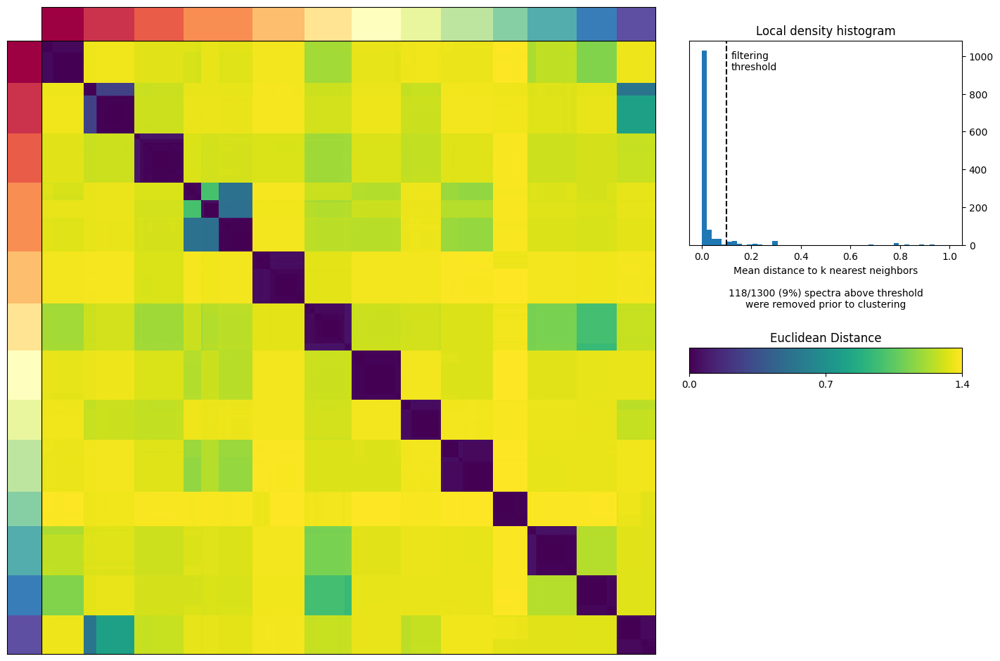

In [ ]:
k_selected = 13


cnmf_obj.consensus(k=k_selected, density_threshold=0.1,show_clustering=True, close_clustergram_fig=False)
usage, spectra_scores, spectra_tpm, top_genes = cnmf_obj.load_results(K=k_selected, density_threshold=0.1)




/tmp/ipython-input-2653057364.py:23: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  avg_usage = usage_with_meta.groupby('condition').mean()


Programs ranked by KRASi specificity:
condition      KRASi        WT  fold_change
Program 9   0.040867  0.018925     2.159305
Program 13  0.001780  0.001061     1.676752
Program 3   0.213646  0.129279     1.652584
Program 10  0.028023  0.020088     1.394966
Program 11  0.015841  0.011630     1.362049
Program 12  0.011409  0.008833     1.291444
Program 4   0.082855  0.066088     1.253683
Program 8   0.044168  0.037735     1.170445
Program 7   0.043809  0.042935     1.020331
Program 1   0.302560  0.363734     0.831813
Program 2   0.121616  0.160854     0.756062
Program 5   0.055870  0.074035     0.754631
Program 6   0.037557  0.064804     0.579532


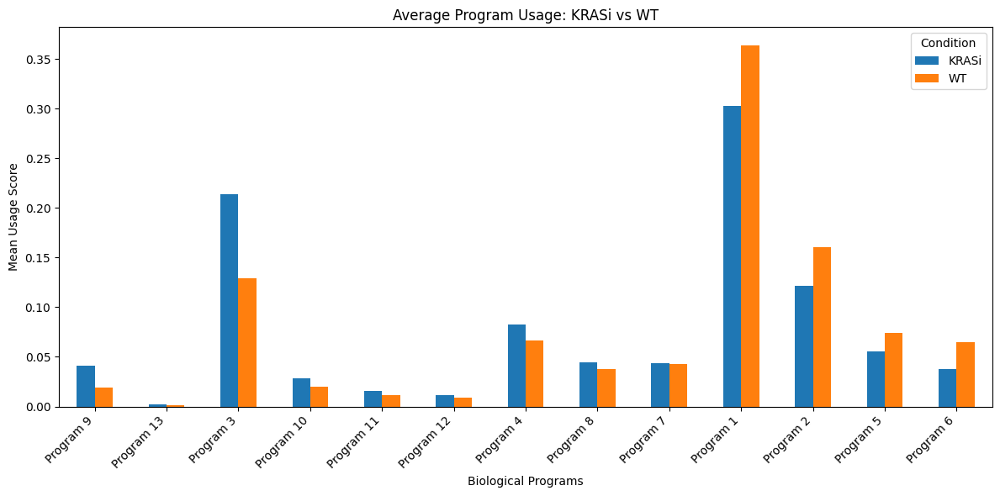

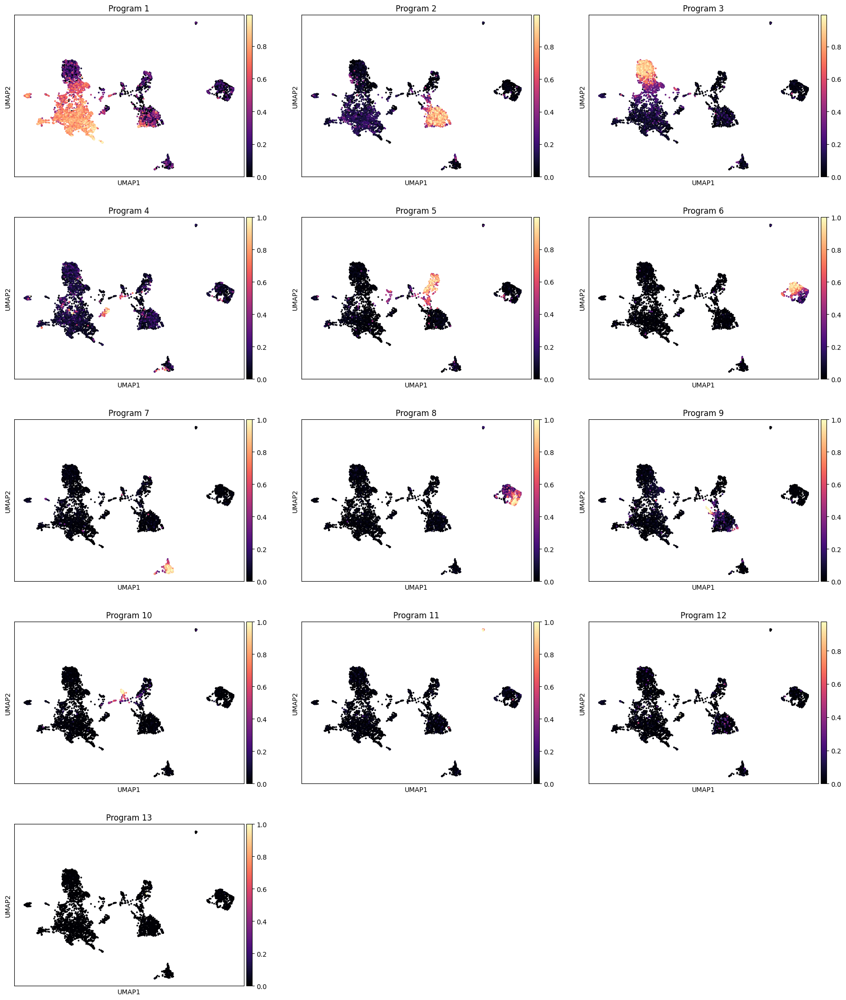

In [ ]:
program_map = {
    1:  'Program 1',
    2:  'Program 2',
    3:  'Program 3',
    4:  'Program 4',
    5:  'Program 5',
    6:  'Program 6',
    7:  'Program 7',
    8:  'Program 8',
    9: 'Program 9',
    10: 'Program 10',
    11: 'Program 11',
    12: 'Program 12',
    13: 'Program 13',
}



immune_adata_cnmf = immune_adata[usage.index, :].copy()
usage_with_meta = usage.copy()
usage_with_meta['condition'] = immune_adata_cnmf.obs['condition'].values

avg_usage = usage_with_meta.groupby('condition').mean()
comparison = avg_usage.T

comparison.index = comparison.index.map(program_map)

comparison['fold_change'] = comparison['KRASi'] / (comparison['WT'] + 1e-6)
comparison = comparison.sort_values('fold_change', ascending=False)

print("Programs ranked by KRASi specificity:")
print(comparison)

comparison[['KRASi', 'WT']].plot(kind='bar', figsize=(12, 6))
plt.title('Average Program Usage: KRASi vs WT')
plt.ylabel('Mean Usage Score')
plt.xlabel('Biological Programs')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Condition')
plt.tight_layout()
plt.show()

for prog_id, prog_name in program_map.items():
    immune_adata_cnmf.obs[prog_name] = usage[prog_id]

program_names = list(program_map.values())

sc.pl.umap(immune_adata_cnmf, color=program_names, cmap='magma', ncols=3)

In [ ]:
cmo_to_tumor = {
    'CMO301': '3341_T1', 'CMO306': '3341_T2_TM2', 'CMO302': '3336_T1',
    'CMO305': '3341_TM1', 'CMO304': '3333_TM1', 'CMO311': '3337_T1',
    'CMO308': '3343_T1', 'CMO307': '3347_T1', 'CMO309': '3346_T1',
    'CMO303': '3337_3353_TM1', 'CMO310': '3347_TM1', 'CMO312': '3346_TM1'
}


immune_adata_cnmf.obs['tumor'] = immune_adata_cnmf.obs['CMO'].map(cmo_to_tumor)
immune_adata_cnmf.obs['mouse'] = immune_adata_cnmf.obs['tumor'].str.split('_').str[0]


baseline_tb_map = {
    '3341_T1': 'High', '3341_T2_TM2': 'High', '3341_TM1': 'High',
    '3336_T1': 'Low',
    '3333_TM1': 'Medium',
    '3343_T1': 'High',
    '3346_T1': 'High', '3346_TM1': 'High',
    '3347_T1': 'Medium', '3347_TM1': 'Medium',
    '3337_T1': 'High', '3337_3353_TM1': 'High'
}

sample_type_map = {
    '3341_T1': 'Tumor', '3341_T2_TM2': 'Tumor', '3341_TM1': 'Tumor Mix',
    '3336_T1': 'Tumor',
    '3333_TM1': 'Tumor Mix',
    '3343_T1': 'Tumor',
    '3346_T1': 'Tumor', '3346_TM1': 'Tumor Mix',
    '3347_T1': 'Tumor', '3347_TM1': 'Tumor Mix',
    '3337_T1': 'Tumor', '3337_3353_TM1': 'Tumor Mix'
}

immune_adata_cnmf.obs['baseline_tb'] = immune_adata_cnmf.obs['tumor'].map(baseline_tb_map)
immune_adata_cnmf.obs['sample_type'] = immune_adata_cnmf.obs['tumor'].map(sample_type_map)


immune_adata_cnmf.obs['baseline_tb'] = immune_adata_cnmf.obs['baseline_tb'].astype('category')
immune_adata_cnmf.obs['sample_type'] = immune_adata_cnmf.obs['sample_type'].astype('category')

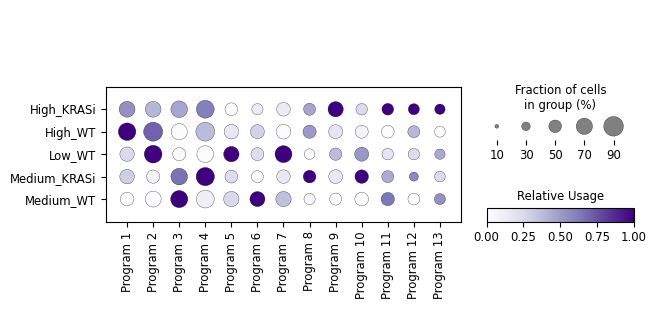

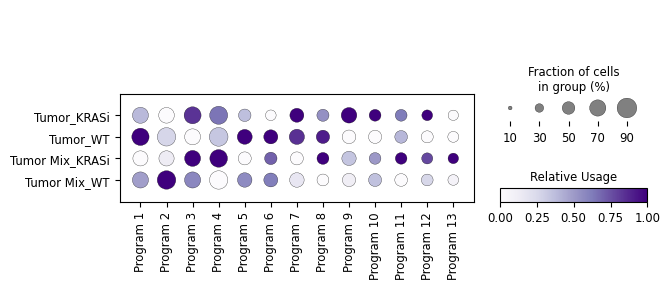

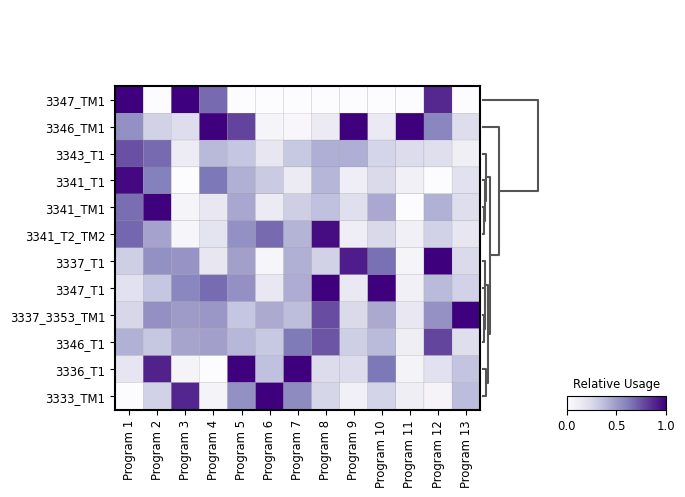

In [ ]:

sc.pl.dotplot(
    immune_adata_cnmf,
    var_names=program_names,
    groupby=['baseline_tb','condition'],
    cmap='Purples',
    standard_scale='var',
    colorbar_title='Relative Usage',
)


sc.pl.dotplot(
    immune_adata_cnmf,
    var_names=program_names,
    groupby=['sample_type', 'condition'],
    cmap='Purples',
    standard_scale='var',
    colorbar_title='Relative Usage',
)

sc.tl.dendrogram(
    immune_adata_cnmf,
    groupby='tumor',
    use_rep=None,
    var_names=program_names
)

sc.pl.matrixplot(
    immune_adata_cnmf,
    var_names=program_names,
    groupby='tumor',
    cmap='Purples',
    standard_scale='var',
    colorbar_title='Relative Usage',
    dendrogram=True
)

<Figure size 800x800 with 0 Axes>

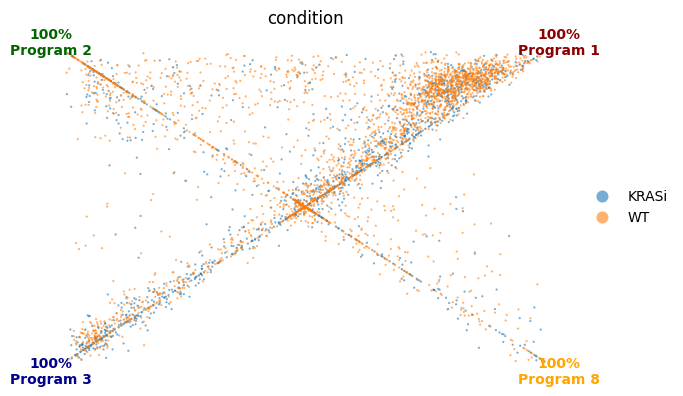

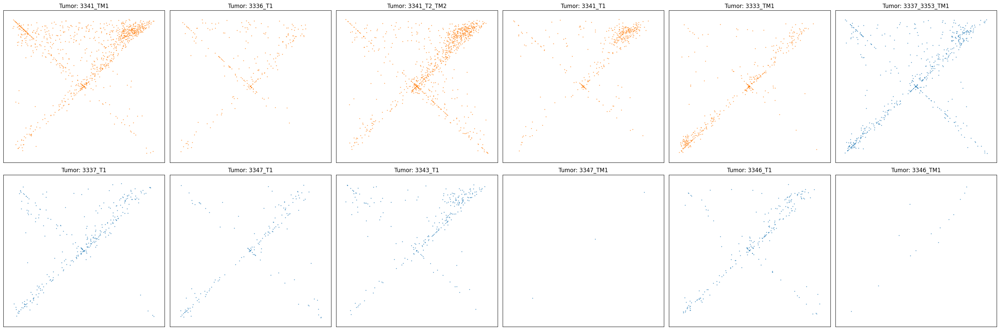

In [ ]:
#Isolate myeloid population


x_raw = immune_adata_cnmf.obs['Program 1'] - immune_adata_cnmf.obs['Program 3']
y_raw = immune_adata_cnmf.obs['Program 2'] - immune_adata_cnmf.obs['Program 8']

rotation_factor = np.sqrt(2) / 2
immune_adata_cnmf.obs['quadrant_x'] = (x_raw - y_raw) * rotation_factor
immune_adata_cnmf.obs['quadrant_y'] = (x_raw + y_raw) * rotation_factor

plt.figure(figsize=(8, 8))

sc.pl.scatter(
    immune_adata_cnmf,
    x='quadrant_x',
    y='quadrant_y',
    color=['condition'],
    size=10,
    alpha=0.6,
    show=False
)



limit = 0.8
plt.xlim(-limit, limit)
plt.ylim(-limit, limit)
plt.axis('off')

plt.text(0.75, 0.75, '100%\nProgram 1' , ha='center', va='center', fontweight='bold', color='darkred')
plt.text(-0.75, -0.75, '100%\nProgram 3', ha='center', va='center', fontweight='bold', color='darkblue')
plt.text(-0.75, 0.75, '100%\nProgram 2', ha='center', va='center', fontweight='bold', color='darkgreen')
plt.text(0.75, -0.75, '100%\nProgram 8', ha='center', va='center', fontweight='bold', color='orange')


plt.show()

tumors = immune_adata_cnmf.obs['tumor'].unique()
ncols = 6
nrows = 2

fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))
axes = axes.flatten()
limit = 0.8

for i, tumor in enumerate(immune_adata_cnmf.obs['tumor'].unique()):
    ax = axes[i]
    subset = immune_adata_cnmf[immune_adata_cnmf.obs['tumor'] == tumor]

    sc.pl.scatter(
        subset,
        x='quadrant_x',
        y='quadrant_y',
        color='condition',
        size=15,
        alpha=0.7,
        ax=ax,
        show=False,
        legend_loc='none'
    )

    ax.set_xlim(-limit, limit)
    ax.set_ylim(-limit, limit)

    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel("")
    ax.set_ylabel("")


    #ax.text(0.9, 0.81, '100%\nInjury Response\nPATS Program', ha='center', fontweight='bold', color='darkred', fontsize=8)
    #ax.text(-0.92, -0.9, '100%\nAT2-like', ha='center', fontweight='bold', color='darkblue', fontsize=8)
    #ax.text(-0.92, 0.81, '100%\nHigh Plasticity (Dlk1-Dio3+)', ha='center', fontweight='bold', color='darkgreen', fontsize=8)
    #ax.text(0.9, -0.9, '100%\nGastric-like/Cholesterol Metabolism', ha='center', fontweight='bold', color='orange', fontsize=8)

    ax.set_title(f"Tumor: {tumor}", fontsize=12)


plt.tight_layout()
plt.show()

